In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import display

# Read household dataset and info
From [UCI Machine Learning repository](https://archive.ics.uci.edu/ml/datasets/Individual+household+electric+power+consumption).

In [4]:
FIRST_READ = True

if FIRST_READ:
    custom_date_parser = lambda c: pd.to_datetime(
        c, format="%d/%m/%Y %H:%M:%S", errors="coerce"
    )
    chunksize = 10 ** 5

    list_of_chunks = []

    with pd.read_csv(
        "data/household_power_consumption.txt",
        chunksize=chunksize,
        sep=";",
        parse_dates={"date": ["Date", "Time"]},
        na_values="?",
    ) as reader:
        for chunk in reader:
            list_of_chunks.append(chunk)

    df = pd.concat(list_of_chunks)

## Data types
Attribute info from [UCI Machine Learning repository](https://archive.ics.uci.edu/ml/datasets/Individual+household+electric+power+consumption).

1.date: Date in format dd/mm/yyyy
2.time: time in format hh:mm:ss
3.global_active_power: household global minute-averaged active power (in kilowatt)
4.global_reactive_power: household global minute-averaged reactive power (in kilowatt)
5.voltage: minute-averaged voltage (in volt)
6.global_intensity: household global minute-averaged current intensity (in ampere)
7.sub_metering_1: energy sub-metering No. 1 (in watt-hour of active energy). It corresponds to the kitchen, containing mainly a dishwasher, an oven and a microwave (hot plates are not electric but gas powered).
8.sub_metering_2: energy sub-metering No. 2 (in watt-hour of active energy). It corresponds to the laundry room, containing a washing-machine, a tumble-drier, a refrigerator and a light.
9.sub_metering_3: energy sub-metering No. 3 (in watt-hour of active energy). It corresponds to an electric water-heater and an air-conditioner.

In [46]:
display(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075259 entries, 0 to 2075258
Data columns (total 8 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   date                   datetime64[ns]
 1   Global_active_power    float64       
 2   Global_reactive_power  float64       
 3   Voltage                float64       
 4   Global_intensity       float64       
 5   Sub_metering_1         float64       
 6   Sub_metering_2         float64       
 7   Sub_metering_3         float64       
dtypes: datetime64[ns](1), float64(7)
memory usage: 126.7 MB


None

# Find null values in columns
Null values are represented by '?' in the original csv file. Approximately 1.25% of the rows have missing values. The values are distributed along the dates, with no particular agglomerations (albeit values for entire days are missing). Depending on the time aggregation (hours, days, weeks, or months) a proper treating of the missing values is required.

In [5]:
# Get all the null values
print("Null values per column:")
null_values = df.isna().sum()
null_percent = null_values * 100 / len(df)
null_values_df = pd.DataFrame(
    {"null_values": null_values, "null_value_percent": null_percent}
)
display(null_values_df)

Null values per column:


,null_values,null_value_percent
date,0,0.000000
Global_active_power,25979,1.251844
Global_reactive_power,25979,1.251844
Voltage,25979,1.251844
Global_intensity,25979,1.251844
Sub_metering_1,25979,1.251844
Sub_metering_2,25979,1.251844
Sub_metering_3,25979,1.251844


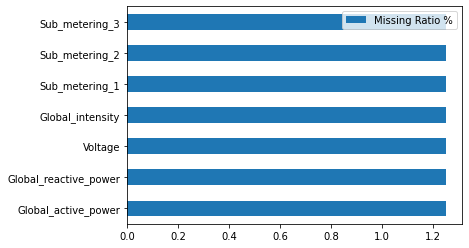

In [6]:
# Plot missing values percentage per column


def plot_nas(dataf: pd.DataFrame):
    if dataf.isnull().sum().sum() != 0:
        na_df = (dataf.isnull().sum() / len(df)) * 100
        na_df = na_df.drop(na_df[na_df == 0].index).sort_values(ascending=False)
        missing_data = pd.DataFrame({"Missing Ratio %": na_df})
        missing_data.plot(kind="barh")
        plt.show()
    else:
        print("No NAs found")


plot_nas(df)

In [42]:
# Plot null values distribution
null_values_columns = df.isna()

# 1 = null value, 0 = valid value
null_values_columns = null_values_columns.astype("int")

# Select rows with nans
rows_with_nan = null_values_columns[null_values_columns > 0].any(axis=1)

# Reset index to the date
null_values_columns.date = df.date
date_range = {
    "min": null_values_columns.date.min(),
    "max": null_values_columns.date.max(),
}

# Select only rows that have 1 or more null values
null_values_columns = null_values_columns[rows_with_nan]


import plotly.graph_objects as go
import plotly.express as px

color_discrete_map = {0: "rgba(255,255,255,255)", 1: px.colors.sequential.Reds[6]}

data = []
tickval = []
ticktext = []

for i, col in enumerate(null_values_columns.drop(columns=["date"]).columns):
    data.append(
        go.Scattergl(
            x=null_values_columns.date,
            y=np.full(len(null_values_columns.date), fill_value=i),
            mode="markers",
            marker=dict(
                color=null_values_columns[col].map(color_discrete_map),
                line=dict(width=0),
            ),
            name=col,
            showlegend=False,
        )
    )
    tickval.append(i)
    ticktext.append(col)

fig = go.Figure(
    data=data,
    layout=dict(
        yaxis=dict(
            tickmode="array",
            tickvals=tickval,
            ticktext=ticktext,
        ),
        title="Distribution of null values",
    ),
)

fig.show()

# Create index as date
Dates in this dataset have temporal resolution of 1 minute.

In [55]:
print(f"Length: {len(df.date)}, Unique: {len(df.date.unique())}")

# Get first and last date
time_delta = df.date.max() - df.date.min()
dates = {
    "min": df.date.min(),
    "max": df.date.max(),
    "data_unique_values": len(df.date.unique()),
    "expected_values": int(time_delta / pd.Timedelta(minutes=1)),
}
display(dates)

# Get dates duplicates
duplicated_index = df.date.duplicated(keep=False)

if duplicated_index.sum() > 0:
    print(f"{duplicated_index.sum()} duplicated indexes")
else:
    print("No duplicated dates")


if dates["expected_values"] > dates["data_unique_values"]:
    print(
        f"Original dataset is missing {int(dates['expected_values'] - dates['data_unique_values'])} dates"
    )
elif dates["expected_values"] < dates["data_unique_values"]:
    print(
        f"Original dataset has {int(dates['data_unique_values']- dates['expected_values'])} more values than expected"
    )
else:
    print("Great, original dataset dates match the expected dates")

Length: 2075259, Unique: 2075259


{'min': Timestamp('2006-12-16 17:24:00'),
 'max': Timestamp('2010-12-11 23:59:00'),
 'data_unique_values': 2075259,
 'expected_values': 2097035}

No duplicated dates
Original dataset is missing 21776 dates


In [48]:
df.set_index("date", inplace=True, drop=False)

,date,Global_active_power,Global_reactive_power,Voltage,Global_intensity,Sub_metering_1,Sub_metering_2,Sub_metering_3
date,,,,,,,,
2007-11-12 17:33:00,2007-11-12 17:33:00,2.740,0.050,235.92,11.6,0.0,0.0,0.0
2008-03-10 06:06:00,2008-03-10 06:06:00,0.342,0.102,240.33,1.4,0.0,0.0,1.0
2007-07-05 20:41:00,2007-07-05 20:41:00,0.240,0.100,235.25,1.0,0.0,0.0,0.0
2009-11-07 16:29:00,2009-11-07 16:29:00,0.468,0.172,244.20,2.2,0.0,0.0,1.0
2008-09-23 05:06:00,2008-09-23 05:06:00,0.352,0.242,239.85,1.8,0.0,1.0,0.0


# Look for missing dates in the date index

In [49]:
# Get dates duplicates
duplicated_index = df.index.duplicated(keep=False)

if duplicated_index.sum() > 0:
    print(f"{duplicated_index.sum()} duplicated indexes")
else:
    print("No duplicated dates")

No duplicated dates


In [50]:
# If I need to reindex with minutes resolution
new_index = pd.date_range(df.index.min(), df.index.max(), freq="T")

DatetimeIndex(['2006-12-16 17:24:00', '2006-12-16 17:25:00',
               '2006-12-16 17:26:00', '2006-12-16 17:27:00',
               '2006-12-16 17:28:00', '2006-12-16 17:29:00',
               '2006-12-16 17:30:00', '2006-12-16 17:31:00',
               '2006-12-16 17:32:00', '2006-12-16 17:33:00',
               ...
               '2010-12-11 23:50:00', '2010-12-11 23:51:00',
               '2010-12-11 23:52:00', '2010-12-11 23:53:00',
               '2010-12-11 23:54:00', '2010-12-11 23:55:00',
               '2010-12-11 23:56:00', '2010-12-11 23:57:00',
               '2010-12-11 23:58:00', '2010-12-11 23:59:00'],
              dtype='datetime64[ns]', length=2097036, freq='T')


## Missing dates (and minutes for each date)

In [101]:
# Select values in the new index that are missing from the dataset index
missing_dates = new_index[~new_index.isin(df.index)]

# Missing days
days_df = pd.DataFrame({"dates": missing_dates, "missing_minutes": 1})
days_df.set_index("dates", drop=True, inplace=True)
days_df = days_df.resample("D").count()
days_df = days_df[days_df.missing_minutes > 0]

display(days_df)

,missing_minutes
dates,
2010-01-12,1440
2010-02-12,1440
2010-03-12,1440
2010-04-12,1440
2010-05-12,1440
2010-06-12,1440
2010-07-12,1440
2010-08-12,1440
2010-09-12,1440


In [109]:
fig = px.scatter(x=days_df.index, y=days_df.missing_minutes)
fig.update_layout(
    width=800,
    xaxis_title="date",
    yaxis_title="missing [min/day]",
    title="Missing dates",
)
fig.show()

## Exclude dates after November 26 2010

In [110]:
df = df.loc[df.index < "2010-11-27"]
display(df.tail())

,date,Global_active_power,Global_reactive_power,Voltage,Global_intensity,Sub_metering_1,Sub_metering_2,Sub_metering_3
date,,,,,,,,
2010-11-26 20:58:00,2010-11-26 20:58:00,0.946,0.0,240.43,4.0,0.0,0.0,0.0
2010-11-26 20:59:00,2010-11-26 20:59:00,0.944,0.0,240.00,4.0,0.0,0.0,0.0
2010-11-26 21:00:00,2010-11-26 21:00:00,0.938,0.0,239.82,3.8,0.0,0.0,0.0
2010-11-26 21:01:00,2010-11-26 21:01:00,0.934,0.0,239.70,3.8,0.0,0.0,0.0
2010-11-26 21:02:00,2010-11-26 21:02:00,0.932,0.0,239.55,3.8,0.0,0.0,0.0


# Interpolate missing values and save to parquet

In [111]:
# Interpolate missing values
df = df.drop(columns="date")
df = df.interpolate()

In [112]:
df.to_parquet("data/household.parquet")